# Capstone Project - The Battle of Neighborhoods
## Project for Applied Data Science Capstone by IBM on Coursera
## By: Eric J. Puttock (August 16, 2020)



## Introduction.

In the changing world today, we are always interested in venues around us. People are often curious to the kinds of restaurants, shops, or entertainment venues exist in their area to spend time with friends and family. This project aims to identify the most common venues of each city within Los Angeles County and to determine whether certain cities can provide similar experiences. The project will also attempt to determine whether more population of a city show differences or similarities among different cities. The audience for this project is primarily for people who are planning to live within Los Angeles County, or for beginner data scientists interested in getting started.

## Data.

This project utilizes the 2010 Census data of each city of Los Angeles County obtained from Wikipedia (https://en.wikipedia.org/wiki/List_of_cities_in_Los_Angeles_County,_California). Geospatial coordinates of each city was used together the help of Foursquare API (https://foursquare.com/) to obtain top venues. Finally, a publicly available GeoJSON file from Geohub LACity (https://geohub.lacity.org/datasets/lacounty::city-boundaries-3) was used to outline the boundaries of each city in the county on OpenStreetMap. Python and several popular libraries (pandas, sklearn, matplotlib, etc.) were used to complete this project. Additionally, folium was used to help visualize the data on OpenStreetMap.

## Methodology.

The pandas library was used to extract 2010 Census population data of each city of Los Angeles County from Wikipedia (https://en.wikipedia.org/wiki/List_of_cities_in_Los_Angeles_County,_California). I broke up the cities by population size into four distinct sizes (Low, Medium, High, Extreme). Two outliers (Los Angeles & Long Beach) were placed in their own Extreme group. Low, Medium, and High were split into three sets of equal number of cities. Additional information regarding when the city was established was also available from the Wiki page but was not used in this study. Nominatim, a search engine for OpenStreetMap data was used to identify the geospatial coordinates of each city. Using the geospatial coordinates and the Foursquare API, we explored venues within 2-miles of each city (and restricted to first 100 venues obtained). To do this, we used a regular endpoint get request to venues/explore (https://api.foursquare.com/v2/venues/explore). After extracting and cleaning up the data, top 10 most common venues of each city was obtained. Using a common unsupervised learning algorithm called K-Means, we grouped cities together based on their similarities to most common venues. This helps identify venues nearest to your current location and provide ideas for future planning. Additionally, simple bar graphs demonstrating which venues were common grouped by population or the K-Means clustering were used to visualize. Finally, using Folium we produce a world map and choropleth map showing the geographical location of each city, how they clustered together (shared colors), and their population groups. The codes used for this project is publicly available for download from my github account (https://github.com/EJPanda/Coursera_Capstone).

# Results.

The following cell will include the packages needed for project/study that was conducted on Los Angeles County, California, USA.

Remark: Install folium (and any other relevant packages) if you haven't used it before.

In [1]:
# For Data Tables & Scientific Computing:
import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
import numpy as np

# For K-Means (Machine Learning)
from sklearn.cluster import KMeans

# For Visualization
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors

# For geospatial coordinates
import geocoder
from geopy.geocoders import Nominatim 

# For Folumn/Choropleth World Maps:
#!conda install -c conda-forge folium=0.5.0 --yes
import folium # plotting library

# For GET requests to Foursquare API:
import requests # library to handle requests

# Read in cities of Los Angeles County from Wiki Page

In [2]:
LA_Cities = "https://en.wikipedia.org/wiki/List_of_cities_in_Los_Angeles_County,_California"
LA_City_2010_Census = pd.read_html(LA_Cities)[0]
LA_City_2010_Census.to_csv('EJP_LA_City_2010_Census.csv',index=False,encoding='utf-8-sig')
LA_City_2010_Census.tail()

,City,Date incorporated,Population as of(2010 Census)
83,Walnut,"January 19, 1959",29172
84,West Covina,"February 17, 1923",106098
85,West Hollywood,"November 29, 1984",34399
86,Westlake Village,"December 11, 1981",8270
87,Whittier,"February 28, 1898",85331


We will gradually clean up the data and create dataframes for the data. We ignore Date incorporated for the project.

In [3]:
EJP_CP = LA_City_2010_Census.rename(columns = {'Population as of(2010 Census)':'Population'})[['City','Population']]
EJP_CP.tail()

,City,Population
83,Walnut,29172
84,West Covina,106098
85,West Hollywood,34399
86,Westlake Village,8270
87,Whittier,85331


We can see how many cities, what the mean,std, minimum, maximum, and the 25th/50th/75th percentile of our population.

Remark: This data is highly skewed due to Los Angeles and Long Beach as you will see the following box plot.

In [4]:
EJP_CP.describe().T

,count,mean,std,min,25%,50%,75%,max
Population,88.0,100128.738636,403102.100353,112.0,20213.5,39767.0,80949.25,3792621.0


If we do a box plot, we see several outliers appear in terms of the general city.

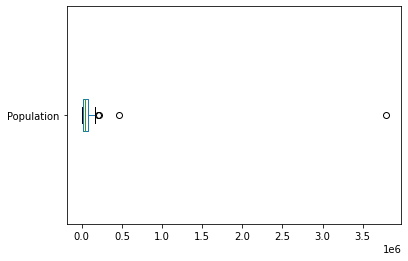

In [5]:
EJP_CP['Population'].plot(kind='box', vert=False)
plt.show()

Let's see what some of those outliers are by sorting the population.

In [6]:
EJP_CPsorted = EJP_CP.sort_values(by=['Population'],ascending=False)
EJP_CPsorted.head(10)

,City,Population
48,Los Angeles,3792621
47,Long Beach,462257
72,Santa Clarita,210888
28,Glendale,203054
44,Lancaster,160316
57,Palmdale,152750
62,Pomona,149058
81,Torrance,145438
60,Pasadena,137122
25,El Monte,113475


As one could see, there's a significant population gap between Los Angeles and Long Beach.

Let's see how the distribution looks like without these outliers.

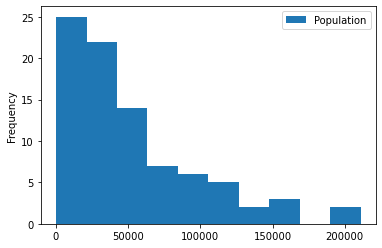

,count,mean,std,min,25%,50%,75%,max
Population,86.0,52981.988372,46010.897528,112.0,20148.5,39300.5,76309.5,210888.0


In [7]:
Mask = (EJP_CPsorted['City'] != 'Los Angeles') & (EJP_CPsorted['City'] != 'Long Beach')
EJP_CPsortedM = EJP_CPsorted[Mask][['Population']]
EJP_CPsortedM.plot(kind='hist')
plt.show()
EJP_CPsortedM.describe().T

Let's bin these into three population groups of roughly the same size.

Long Beach and Los Angeles will be grouped together to form its own group.

We assign to each city an interval group relative to their population using pandas qcut method.

This divides up the data into q many intervals of equal size (as much as possible).

In [8]:
NoMaskList = pd.qcut(EJP_CPsorted[~Mask]['Population'], q=1)
MaskList = pd.qcut(EJP_CPsorted[Mask]['Population'], q=3)
EJP_CPsorted['Group #'] = pd.concat([NoMaskList, MaskList], axis=0)
EJP_CPsorted.head()

,City,Population,Group #
48,Los Angeles,3792621,"(462256.999, 3792621.0]"
47,Long Beach,462257,"(462256.999, 3792621.0]"
72,Santa Clarita,210888,"(58590.667, 210888.0]"
28,Glendale,203054,"(58590.667, 210888.0]"
44,Lancaster,160316,"(58590.667, 210888.0]"


Next, we assign names to each of the groups that are appropriate for our understanding.

The group names were assigned relative to the Los Angeles County population. And sorted the index back starting from 0.

We will later use this for our choropleth map.

In [9]:
GroupNames = ['Extreme','High','Medium','Low']
for j,val in enumerate(EJP_CPsorted['Group #'].unique()):
    EJP_CPsorted['Group #'] = EJP_CPsorted['Group #'].replace(val,3-j)
    print('Group {} ({}) corresponds to interval {}.'.format(3-j, GroupNames[j] ,val))
EJP_CPsorted['Group'] = EJP_CPsorted['Group #'].map({3: 'Extreme', 2: 'High', 1: 'Medium', 0: 'Low' })
EJP_CPP = EJP_CPsorted.sort_index()
EJP_CPP.head()

Group 3 (Extreme) corresponds to interval (462256.999, 3792621.0].
Group 2 (High) corresponds to interval (58590.667, 210888.0].
Group 1 (Medium) corresponds to interval (24409.667, 58590.667].
Group 0 (Low) corresponds to interval (111.999, 24409.667].


,City,Population,Group #,Group
0,Agoura Hills,20330,0,Low
1,Alhambra,83653,2,High
2,Arcadia,56364,1,Medium
3,Artesia,16522,0,Low
4,Avalon,3728,0,Low


For the sake of checking that the data was grouped as intended, we check the total count of each group.

Recall: Los Angeles and Long Beach are outliers, and they form the Extreme group.

In [10]:
PopGroupCounts = EJP_CPsorted[['City','Group']].groupby('Group').count().rename(columns={'City':'Counts'})
PopGroupCounts.reset_index(inplace=True)
PopGroupCounts

,Group,Counts
0,Extreme,2
1,High,29
2,Low,29
3,Medium,28


# Utilizing Geocoder - Nominatim OpenStreetMap and Foursquare API:
## Learn about the cities of Los Angeles County.
Using Geocoder - Nominatim OpenStreetMap we find the geospatial coordinates of each city name in Los Angeles County.

Using the Foursquare API, we determine the top 10 most common venues of each city of Los Angeles County. We do this by finding 100 venues within a 2-mile radius (roughly 2319 meters) from the geographical coordinates of each city. For each city, we extract the top 10 venues category. Note that this doesn't necessarily mean the venue is necessarily popular but exist in greater quantities in comparison to other venues within the city range.

## Identify the coordinates of Los Angeles, California
The coordinates here will be used for our Folium world map plots.

Originally, Los Angeles County coordinates were used, but the map becomes off center since the county is wide.

We center the map around Los Angeles.

In [11]:
address = 'Los Angeles, Los Angeles County, California'
geolocator = Nominatim(user_agent="LA_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geographical coordinate of {} is {}, {}.'.format(address,latitude, longitude))

The geographical coordinate of Los Angeles, Los Angeles County, California is 34.0536909, -118.2427666.


We identify all relevant coordinates of each city and create a data frame.

In [12]:
def GeoLocEJP(RegionName = "Los Angeles"):
    addressx = '{}, Los Angeles County, California'.format(RegionName)
    geolocatorx = Nominatim(user_agent="LA_explorer")
    locationx = geolocatorx.geocode(addressx)
    latitudex = locationx.latitude
    longitudex = locationx.longitude
    return addressx,latitudex,longitudex
LatList = []; LngList = [];
EJP_CLL = EJP_CP[['City']]
for CityName in EJP_CP['City']:
    Addr,Lat,Lng = GeoLocEJP(CityName)
    LatList.append(Lat)
    LngList.append(Lng)
    #print('The geographical coordinate of {} is {}, {}.'.format(Addr,Lat,Lng))
EJP_CLL["Latitude"]=LatList
EJP_CLL["Longitude"]=LngList
EJP_CLL.to_csv('EJP_CLL.csv',encoding='utf-8-sig')
EJP_CLL.tail()

,City,Latitude,Longitude
83,Walnut,34.020289,-117.865339
84,West Covina,34.068621,-117.938953
85,West Hollywood,34.092301,-118.369289
86,Westlake Village,34.146023,-118.806179
87,Whittier,33.970878,-118.030840


### First to use the Foursquare API, you need to set up an account.
Get your CLIENT ID and CLIENT SECRET. Without these two keys, the Foursquare API will not function.

#### My Foursquare API credentials are hidden as these keys are unique to each user. Never publicly post your keys! 

In [13]:
## Hide:
#<--
CLIENT_ID = '-------------' # your Foursquare ID
CLIENT_SECRET = '-------------' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version
#-->
## Hide:

# Let's identify Venues within our cities.
We consider a 2-mile radius around each city and find the first 100 venues provided by the Foursquare API.

In [14]:
miles = 2
miles2meter = 1609.344
# Just want to find the nearest integer closet to 2 miles in meters.
radius4get = round(miles*miles2meter)
print('Radius = {} meters ({} miles)'.format(radius4get, miles))
LIMIT4get=100
print('Limit = {}'.format(LIMIT4get))

Radius = 3219 meters (2 miles)
Limit = 100


In [15]:
def getNearbyVenues(names, latitudes, longitudes, radius=750, LIMIT=100):
    
    venues_list=[]
    no_venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        #print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
        try:    
            # make the GET request
            results = requests.get(url).json()["response"]['groups'][0]['items']
        
            if len(results)==0:
                print(r'**WARNING: {} does not have any categories within {} radius.**'.format(name,radius))
                no_venues_list.append([(name, lat, lng)])
        
            # return only relevant information for each nearby venue
            venues_list.append([(
                name, 
                v['venue']['categories'][0]['name'],
                v['venue']['name'], 
                v['venue']['location']['lat'], 
                v['venue']['location']['lng']) for v in results])
        except:
            print('Failed to make the GET request for {}.'.format(name))
            no_venues_list.append([(name, lat, lng)])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['City',  
                  'Venue Category',
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude']
    if len(no_venues_list)>0:
        no_nearby_venues = pd.DataFrame([item for no_venue_list in no_venues_list for item in no_venue_list])
        no_nearby_venues.columns = ['City', 'City Latitude', 'City Longitude'] 
    else:
        no_nearby_venues = pd.DataFrame(columns = ['City', 'City Latitude', 'City Longitude'])
    
    return(nearby_venues, no_nearby_venues)

In [17]:
EJP_CVenueTNLL, no_EJP_CVenueTNLL = getNearbyVenues(names=EJP_CLL['City'],
                                   latitudes=EJP_CLL['Latitude'],
                                   longitudes=EJP_CLL['Longitude'],
                                            radius = radius4get,
                                            LIMIT = LIMIT4get)

Here, in the interest of time, if you don't want to run through the API calls the following codes should be run.

In [16]:
no_EJP_CVenueTNLL = pd.DataFrame(columns = ['City', 'City Latitude', 'City Longitude'])
EJP_CVenueTNLL = pd.read_csv('EJP_CVenueTNLL.csv',index_col=0,encoding='utf-8-sig')

In [17]:
no_EJP_CVenueTNLL.head()

,City,City Latitude,City Longitude


In [18]:
#EJP_CVenueTNLL.to_csv('EJP_CVenueTNLL.csv',encoding='utf-8-sig')
EJP_CVenueTNLL.head()

,City,Venue Category,Venue,Venue Latitude,Venue Longitude
0,Agoura Hills,Fast Food Restaurant,El Pollo Loco,34.144732,-118.761088
1,Agoura Hills,Deli / Bodega,Italia Deli & Bakery,34.153099,-118.759037
2,Agoura Hills,Brewery,Ladyface Alehouse & Brasserie,34.143834,-118.762823
3,Agoura Hills,Grocery Store,Trader Joe's,34.146241,-118.756609
4,Agoura Hills,Dessert Shop,Tifa Chocolate & Gelato,34.144586,-118.754595


In [19]:
EJP_UniqueVenues = pd.DataFrame({'Venue Category':sorted(EJP_CVenueTNLL['Venue Category'].unique())})
print('There are {} unique venues found.'.format(EJP_UniqueVenues.shape[0]))
EJP_UniqueVenues.to_csv('EJP_CVenueTNLL_Names.csv',encoding='utf-8-sig')

There are 337 unique venues found.


In [21]:
EJP_UniqueVenues.T

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336
Venue Category,ATM,Accessories Store,Advertising Agency,African Restaurant,Airport,Airport Lounge,Airport Terminal,American Restaurant,Animal Shelter,Antique Shop,Aquarium,Arcade,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Australian Restaurant,Auto Dealership,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Court,Beach,Beach Bar,Bed & Breakfast,Beer Bar,Beer Garden,Big Box Store,Bike Trail,Bistro,Board Shop,Boat or Ferry,Bookstore,Boutique,Bowling Alley,Brazilian Restaurant,Breakfast Spot,Brewery,Bubble Tea Shop,Buffet,Building,Burger Joint,Burrito Place,Bus Station,Business Service,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Cambodian Restaurant,Camera Store,Campground,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Casino,Cheese Shop,Chinese Restaurant,Chocolate Shop,Church,Climbing Gym,Clothing Store,Club House,Cocktail Bar,Coffee Shop,College Arts Building,College Bookstore,College Cafeteria,College Theater,Comedy Club,Comic Shop,Community Center,Concert Hall,Construction & Landscaping,Convenience Store,Convention Center,Cosmetics Shop,Costume Shop,Credit Union,Creperie,Cuban Restaurant,Cupcake Shop,Cycle Studio,Dance Studio,Deli / Bodega,Department Store,Design Studio,Dessert Shop,Dim Sum Restaurant,Diner,Disc Golf,Discount Store,Distillery,Dive Bar,Dive Shop,Dive Spot,Dog Run,Donburi Restaurant,Donut Shop,Dry Cleaner,Dumpling Restaurant,Eastern European Restaurant,Electronics Store,Event Space,Fabric Shop,Fair,Farm,Farmers Market,Fast Food Restaurant,Field,Filipino Restaurant,Film Studio,Fish & Chips Shop,Fish Market,Fishing Store,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Truck,Football Stadium,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Gluten-free Restaurant,Golf Course,Golf Driving Range,Gourmet Shop,Government Building,Greek Restaurant,Grocery Store,Gun Range,Gym,Gym / Fitness Center,Gym Pool,Gymnastics Gym,Harbor / Marina,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,High School,Historic Site,History Museum,Hobby Shop,Home Service,Hookah Bar,Hot Dog Joint,Hotel,Hotel Bar,Hotel Pool,Hotpot Restaurant,IT Services,Ice Cream Shop,Indian Chinese Restaurant,Indian Restaurant,Indie Movie Theater,Indie Theater,Indonesian Restaurant,Insurance Office,Intersection,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jewelry Store,Jewish Restaurant,Juice Bar,Karaoke Bar,Kids Store,Kitchen Supply Store,Korean Restaurant,Lake,Latin American Restaurant,Laundromat,Library,Light Rail Station,Li

# For each city, we identify the Top 10 most common venues.

We start by identifying which cities contain which venues. This is done using pandas get_dummies() method, sometimes called one hot encoding.

Each city is then normalized to their relative venue count to compute the relative fractions of each venue category.

Then, the top 10 most common venues are selected, and placed into a data frame.

In [22]:
# one hot encoding
EJP_LAC_onehot = pd.get_dummies(EJP_CVenueTNLL[['Venue Category']], prefix="", prefix_sep="")
# add city column back to dataframe
EJP_LAC_onehot['City'] = EJP_CVenueTNLL['City']
# move city column to the first column
fixed_columns = [EJP_LAC_onehot.columns[-1]] + list(EJP_LAC_onehot.columns[:-1])
EJP_LAC_onehot = EJP_LAC_onehot[fixed_columns]

# let's group rows by city and by taking the mean of the frequency of occurrence of each category
EJP_LAC_grouped = EJP_LAC_onehot.groupby('City').mean().reset_index()
#LAC_grouped.shape

In [23]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    # Some neighboorhoods don't have enough venues. In this case, we want to return 'No More Venues'.
    LRCS = len(row_categories_sorted.index.values[row_categories_sorted!=0])
    
    if LRCS < num_top_venues:
        output = row_categories_sorted.index.values[0:LRCS]
        for k in range(LRCS,num_top_venues):
            output=np.insert(output,len(output),'No More Venues')
        return output
    else:
        output = row_categories_sorted.index.values[0:num_top_venues]
        return output

In [24]:
# Adjust this parameter if you want more or less.
num_top_venues = 10
indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['City']

for ind in np.arange(num_top_venues):
    #columns.append('Most Common Venue')
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
EJP_city_venues_sorted = pd.DataFrame(columns=columns)
EJP_city_venues_sorted['City'] = EJP_LAC_grouped['City']

for ind in np.arange(EJP_LAC_grouped.shape[0]):
    EJP_city_venues_sorted.iloc[ind, 1:] = return_most_common_venues(EJP_LAC_grouped.iloc[ind, :], num_top_venues)
    
EJP_city_venues_sorted.to_csv('EJP_city_venues_sorted.csv',encoding='utf-8-sig')
EJP_city_venues_sorted.tail()

,City,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
83,Walnut,Fast Food Restaurant,Pizza Place,Park,Coffee Shop,Japanese Restaurant,Mexican Restaurant,Asian Restaurant,Furniture / Home Store,Sandwich Place,Liquor Store
84,West Covina,Mexican Restaurant,Pharmacy,Coffee Shop,Fast Food Restaurant,Ice Cream Shop,Grocery Store,Burger Joint,Thai Restaurant,Asian Restaurant,Bubble Tea Shop
85,West Hollywood,Hotel,Café,New American Restaurant,Coffee Shop,Gym,Gym / Fitness Center,Cocktail Bar,Clothing Store,Boutique,French Restaurant
86,Westlake Village,Italian Restaurant,American Restaurant,Hotel,Mexican Restaurant,Sushi Restaurant,Brewery,Grocery Store,Park,Burger Joint,Seafood Restaurant
87,Whittier,Mexican Restaurant,Fast Food Restaurant,Coffee Shop,Trail,Donut Shop,American Restaurant,Bakery,Pharmacy,Convenience Store,Rental Car Location


# Let's apply K-means to determine if we can form clusters of cities that are similar.

In some rare cases, we may encounter cities without any venues (small radius for example). We take care of these missing cases.

Pad the rows with 0's for the city without any venues.

If all cities are already accounted for, then we get an empty data frame and everything is fine.

In [25]:
no_EJP_CVenueTNLL.head()

,City,City Latitude,City Longitude


In [26]:
for cityname in no_EJP_CVenueTNLL['City'].values:
    EJP_LAC_grouped = EJP_LAC_grouped.append(pd.Series(np.zeros(EJP_LAC_grouped.shape[1]), index=EJP_LAC_grouped.columns), ignore_index=True)
    EJP_LAC_grouped['City'] = EJP_LAC_grouped['City'].replace(0,cityname)
#print(LAC_grouped.shape)
EJP_LAC_grouped.tail()

,City,ATM,Accessories Store,Advertising Agency,African Restaurant,Airport,Airport Lounge,Airport Terminal,American Restaurant,Animal Shelter,Antique Shop,Aquarium,Arcade,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Australian Restaurant,Auto Dealership,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Court,Beach,Beach Bar,Bed & Breakfast,Beer Bar,Beer Garden,Big Box Store,Bike Trail,Bistro,Board Shop,Boat or Ferry,Bookstore,Boutique,Bowling Alley,Brazilian Restaurant,Breakfast Spot,Brewery,Bubble Tea Shop,Buffet,Building,Burger Joint,Burrito Place,Bus Station,Business Service,Butcher,Cafeteria,Café,Cajun / Creole Restaurant,Cambodian Restaurant,Camera Store,Campground,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Casino,Cheese Shop,Chinese Restaurant,Chocolate Shop,Church,Climbing Gym,Clothing Store,Club House,Cocktail Bar,Coffee Shop,College Arts Building,College Bookstore,College Cafeteria,College Theater,Comedy Club,Comic Shop,Community Center,Concert Hall,Construction & Landscaping,Convenience Store,Convention Center,Cosmetics Shop,Costume Shop,Credit Union,Creperie,Cuban Restaurant,Cupcake Shop,Cycle Studio,Dance Studio,Deli / Bodega,Department Store,Design Studio,Dessert Shop,Dim Sum Restaurant,Diner,Disc Golf,Discount Store,Distillery,Dive Bar,Dive Shop,Dive Spot,Dog Run,Donburi Restaurant,Donut Shop,Dry Cleaner,Dumpling Restaurant,Eastern European Restaurant,Electronics Store,Event Space,Fabric Shop,Fair,Farm,Farmers Market,Fast Food Restaurant,Field,Filipino Restaurant,Film Studio,Fish & Chips Shop,Fish Market,Fishing Store,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Truck,Football Stadium,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Gluten-free Restaurant,Golf Course,Golf Driving Range,Gourmet Shop,Government Building,Greek Restaurant,Grocery Store,Gun Range,Gym,Gym / Fitness Center,Gym Pool,Gymnastics Gym,Harbor / Marina,Hardware Store,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,High School,Historic Site,History Museum,Hobby Shop,Home Service,Hookah Bar,Hot Dog Joint,Hotel,Hotel Bar,Hotel Pool,Hotpot Restaurant,IT Services,Ice Cream Shop,Indian Chinese Restaurant,Indian Restaurant,Indie Movie Theater,Indie Theater,Indonesian Restaurant,Insurance Office,Intersection,Italian Restaurant,Japanese Curry Restaurant,Japanese Restaurant,Jewelry Store,Jewish Restaurant,Juice Bar,Karaoke Bar,Kids Store,Kitchen Supply Store,Korean Restaurant,Lake,Latin American Restaurant,Laundromat,Library,Light Rail Station,Lighthouse,Lingerie Store,Liquor Store,Lounge,Mac & Cheese Joint,Malay Restaurant,Market,Martial Arts School,Massage Studio,Medical Center,Mediterranean Restaurant,Men's Store,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Moroccan Restaurant,Motel,Motorcycle Shop,Motorsports Shop,Mountain,Movie Theater,Multiplex,Museum,Music Store,Music Venue,Nail Salon,Nature Preserve,Neighborhood,New American Restaurant,Night Market,Nightclub,Noodle House,North Indian Restaurant,Office,Optical Shop,Organic Grocery,Other Great Outdoors,Other Repair Shop,Outlet Mall,Paper / Office Supplies Store,Park,Performing Arts Venue,Peruvian Restaurant,Pet Café,Pet Service,Pet Store,Pharmacy,Piano Bar,Pie Shop,Pier,Pizza Place,Playground,Plaza,Poke Place,Polish Restaurant,Pool,Post Office,Pub,Racetrack,Ramen Restaurant,Record Shop,Recording Studio,Recreation Center,Rental Car Location,Rental Service,Resort,Rest Area,Restaurant,Rock Climbing Spot,Rock Club,Roof Deck,Salad Place,Salon / Barbershop,Sandwich Place,Scenic Lookout,Science Museum,Sculpture Garden,Seafood Restaurant,Shabu-Shabu Restaurant,Shipping Store,Shoe Store,Shopping Mall,Shopping Plaza,Skate Park,Skating Rink,Smoke Shop,Smoothie Shop,Snack Place,South Ameri

# K-Means unsupervised clustering to group cities by similarity.

### Make the Training set. This will consist of the fractions of venues of each row.

####  We use the elbow method to visually estimate what an appropriate cluster count should be.
- We measure the Mean-Square-Error (MSE) and determine a cluster size where decrease of MSE slows down.
- We run 12 different initializations for each cluster size, then compare the minimum MSE for each cluster size.

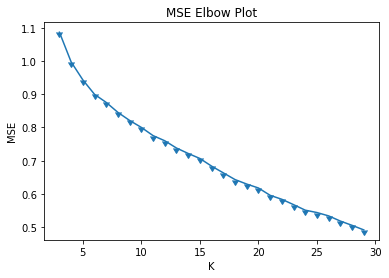

We estimate around cluster size K = 11 there"s a shift in MSE reduction.


In [27]:
# We initialize this for later use:
EJP_LKC = EJP_LAC_grouped[['City']]
# Drop the city column, since we're fitting to the fractions.
DataToFit = EJP_LAC_grouped.drop(columns = ['City'],axis=1)

dist = []
for iternum, kclusters in enumerate(range(3,30)):
    # run k-means clustering with kclusters
    kmeans = KMeans(init="k-means++", n_clusters=kclusters, n_init=12, random_state=4).fit(DataToFit)
    # check cluster labels generated for each row in the dataframe
    dist.append(kmeans.inertia_)
    
plt.plot(np.arange(3,30,1),dist,marker=11)
plt.xlabel('K')
plt.ylabel('MSE')
plt.title('MSE Elbow Plot')
plt.show()

print('We estimate around cluster size K = 11 there"s a shift in MSE reduction.')

We train the model with K-Means with cluster size of 11. Each city is associate with an integer cluster label.

In [28]:
DataToFit = EJP_LAC_grouped.drop(columns = ['City'],axis=1)
# Set number of clusters
kclusters = 11
# run k-means clustering
kmeans = KMeans(init="k-means++", n_clusters=kclusters, n_init=12, random_state=4).fit(DataToFit)

# add clustering labels
EJP_LKC.insert(1, 'K-Means Cluster', kmeans.labels_)
EJP_LKC.head()

,City,K-Means Cluster
0,Agoura Hills,6
1,Alhambra,2
2,Arcadia,6
3,Artesia,0
4,Avalon,10


In [29]:
# Form a table with all our data together.
EJP_LAC_merged = EJP_CLL
EJP_LAC_merged = EJP_LAC_merged.join(EJP_CPP.set_index('City'), on=['City'])
EJP_LAC_merged = EJP_LAC_merged.join(EJP_city_venues_sorted.set_index('City'), on=['City'])
EJP_LAC_merged.loc[:,'1st Most Common Venue':] = EJP_LAC_merged.loc[:,'1st Most Common Venue':].fillna('No More Venues')
EJP_CLLPGV = EJP_LAC_merged.reset_index(drop=True)

# Join the Cluster Labels by City.
EJP_CLLPGCV = EJP_CLLPGV.join(EJP_LKC.set_index('City'), on=['City'])
# move cluster column to the first column
InsertionCol = 4
fixed_columns = list(EJP_CLLPGCV.columns[0:InsertionCol])+ [EJP_CLLPGCV.columns[-1]] + list(EJP_CLLPGCV.columns[InsertionCol:-1])
EJP_CLLPGCV = EJP_CLLPGCV[fixed_columns]
EJP_CLLPGCV.to_csv('EJP_CLLPGCV.csv',index=False,encoding='utf-8-sig')

# In some events, with no venues, we should drop them.
for names in no_EJP_CVenueTNLL['City']:
    EJP_CLLPGCV = EJP_CLLPGCV[EJP_CLLPGCV['City']!=names]
    
EJP_CLLPGCV.to_csv('EJP_CLLPGCV.csv',index=False,encoding='utf-8-sig')

## We finalize our two data frames we will use for visualizing our results.
- Data for each city containing location, population, K-means Cluster, Population Group # and Name, Top 10 most common venues.
- Data for all venues collected.

In [30]:
EJP_LAC_merged.head()

,City,Latitude,Longitude,Population,Group #,Group,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Agoura Hills,34.147910,-118.765704,20330,0,Low,Mexican Restaurant,Fast Food Restaurant,Deli / Bodega,Furniture / Home Store,Indian Restaurant,Shipping Store,BBQ Joint,Sandwich Place,Japanese Restaurant,Ice Cream Shop
1,Alhambra,34.093042,-118.127060,83653,2,High,Chinese Restaurant,Park,Café,Burger Joint,Vietnamese Restaurant,Mexican Restaurant,Italian Restaurant,Fast Food Restaurant,Convenience Store,Bakery
2,Arcadia,34.136207,-118.040150,56364,1,Medium,Bakery,Mexican Restaurant,American Restaurant,Coffee Shop,Grocery Store,Chinese Restaurant,Pizza Place,Sushi Restaurant,Fast Food Restaurant,Breakfast Spot
3,Artesia,33.869020,-118.079620,16522,0,Low,Indian Restaurant,Bakery,Café,Ice Cream Shop,Grocery Store,Sandwich Place,Chinese Restaurant,Thai Restaurant,BBQ Joint,Coffee Shop
4,Avalon,33.342210,-118.327261,3728,0,Low,Hotel,Pizza Place,Bar,Seafood Restaurant,American Restaurant,Beach,Trail,History Museum,Mexican Restaurant,Harbor / Marina


In [31]:
EJP_CVenueTNLL.head()

,City,Venue Category,Venue,Venue Latitude,Venue Longitude
0,Agoura Hills,Fast Food Restaurant,El Pollo Loco,34.144732,-118.761088
1,Agoura Hills,Deli / Bodega,Italia Deli & Bakery,34.153099,-118.759037
2,Agoura Hills,Brewery,Ladyface Alehouse & Brasserie,34.143834,-118.762823
3,Agoura Hills,Grocery Store,Trader Joe's,34.146241,-118.756609
4,Agoura Hills,Dessert Shop,Tifa Chocolate & Gelato,34.144586,-118.754595


# Finally, let's visualize our data using Folium and choropleth!

We build a world map using the Folium package and assign a color to each cluster.

Each city is associated to a cluster and their assigned colors via K-means.

We do recognize some cities are cluster quite similar together. However, we also see interesting differences.

In [32]:
kclusters = len(EJP_CLLPGCV['K-Means Cluster'].unique())
# create map
LAC_cluster_map = folium.Map(location=[latitude, longitude], zoom_start=9)

# set color scheme for the clusters
colors_array = cm.rainbow(np.linspace(0, 1, kclusters))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, city, cluster in zip(EJP_CLLPGCV['Latitude'], EJP_CLLPGCV['Longitude'], EJP_CLLPGCV['City'], EJP_CLLPGCV['K-Means Cluster']):
    label = folium.Popup(str(city) + ' Cluster ' + str(int(cluster)), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[int(cluster)-1],
        fill=True,
        fill_color=rainbow[int(cluster)-1],
        fill_opacity=0.7).add_to(LAC_cluster_map)
       
LAC_cluster_map

# Choropleth map of Los Angeles County together with our API Data.
We obtained a geojson file outlining the boundaries of each city of Los Angeles County provided for the public from lacity.org.
A choropleth map is created by combining our population group sizes from the 2010 census data and combined with our city clustering data. We aim to see if population size, clustering, and top venues are interrelated in any way. From this map, we see that the eastern and southern parts of Los Angeles County are the most populated areas.

In [33]:
# https://geohub.lacity.org/
# City boundaries in Los Angeles County
LAC_geo = r'City_Boundaries.geojson' # geojson file

In [34]:
# create a plain world map
LAC_citymap = folium.Map(location=[latitude, longitude], zoom_start=9)

# generate choropleth map using the total immigration of each country to Canada from 1980 to 2013
LAC_citymap.choropleth(
    geo_data=LAC_geo,
    data=EJP_CLLPGCV, 
    columns=['City', 'Group #'], 
    key_on='feature.properties.CITY_NAME',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Group',
    threshold_scale=range(0,5),
    reset=True
)
    
# display map
LAC_citymap

# Now let's combine our clustering data!

Interestingly, we do see some clusters aligning with different population sizes.

In [35]:
# create a plain world map
LAC_map = folium.Map(location=[latitude, longitude], zoom_start=9)

# generate choropleth map using the total immigration of each country to Canada from 1980 to 2013
LAC_map.choropleth(
    geo_data=LAC_geo,
    data=EJP_CLLPGCV, 
    columns=['City', 'Group #'], 
    key_on='feature.properties.CITY_NAME',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Group',
    threshold_scale=range(0,5),
    reset=True
)

# set color scheme for the clusters
colors_array = cm.rainbow(np.linspace(0, 1, kclusters))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, city, cluster, grp in zip(EJP_CLLPGCV['Latitude'], EJP_CLLPGCV['Longitude'], EJP_CLLPGCV['City'], EJP_CLLPGCV['K-Means Cluster'], EJP_CLLPGCV['Group #']):
    label = folium.Popup('{}, K-Means Cluster {}, Population Group {}'.format(str(city),str(cluster),str(grp)), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[int(cluster)-1],
        fill=True,
        fill_color=rainbow[int(cluster)-1],
        fill_opacity=0.7).add_to(LAC_map)

LAC_map.save('index.html')

# display map
LAC_map

Let's see the common venues and the name of the cities of each cluster.

In [36]:
EJP_Clusters = dict()
for cluster in range(kclusters):
    A = EJP_CLLPGCV[EJP_CLLPGCV['K-Means Cluster']==cluster].loc[:,'City']
    B = EJP_CLLPGCV[EJP_CLLPGCV['K-Means Cluster']==cluster].loc[:,'1st Most Common Venue':'10th Most Common Venue']
    EJP_Clusters[cluster] = pd.concat([A,B],ignore_index=False,axis=1)

In [37]:
EJP_Clusters[0]

,City,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
3,Artesia,Indian Restaurant,Bakery,Café,Ice Cream Shop,Grocery Store,Sandwich Place,Chinese Restaurant,Thai Restaurant,BBQ Joint,Coffee Shop
27,Gardena,Japanese Restaurant,Burger Joint,Sushi Restaurant,Italian Restaurant,Mexican Restaurant,Bakery,Vietnamese Restaurant,Asian Restaurant,BBQ Joint,Fast Food Restaurant
28,Glendale,Middle Eastern Restaurant,Coffee Shop,Japanese Restaurant,Bakery,Gym,Burger Joint,Café,Mediterranean Restaurant,Asian Restaurant,Department Store
38,La Cañada Flintridge,Grocery Store,Coffee Shop,Mexican Restaurant,Pizza Place,Bakery,Garden,Sandwich Place,Italian Restaurant,Sushi Restaurant,Gym / Fitness Center
46,Lomita,Japanese Restaurant,Bakery,Grocery Store,Pizza Place,Sushi Restaurant,Café,Fast Food Restaurant,Sandwich Place,Spa,Park
71,San Marino,Garden,Chinese Restaurant,Fast Food Restaurant,Tea Room,Café,American Restaurant,Gym / Fitness Center,Vietnamese Restaurant,Coffee Shop,Sandwich Place
81,Torrance,Japanese Restaurant,Brewery,Clothing Store,American Restaurant,Korean Restaurant,Bakery,Gym,New American Restaurant,Coffee Shop,Lingerie Store


In [38]:
EJP_Clusters[1]

,City,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
5,Azusa,Fast Food Restaurant,Mexican Restaurant,Burger Joint,American Restaurant,Grocery Store,Coffee Shop,Pizza Place,Breakfast Spot,Convenience Store,Trail
6,Baldwin Park,Mexican Restaurant,Fast Food Restaurant,Burger Joint,Sandwich Place,Grocery Store,Coffee Shop,Pharmacy,Liquor Store,Bakery,Food Truck
8,Bell Gardens,Mexican Restaurant,Fast Food Restaurant,Coffee Shop,Sandwich Place,Park,American Restaurant,Convenience Store,Breakfast Spot,Bakery,Grocery Store
17,Commerce,Mexican Restaurant,Clothing Store,Coffee Shop,Burger Joint,Bakery,Pizza Place,Pharmacy,Shoe Store,Video Game Store,Taco Place
18,Compton,Fast Food Restaurant,Coffee Shop,Convenience Store,Pizza Place,Discount Store,Sandwich Place,Mexican Restaurant,Burger Joint,Grocery Store,Wings Joint
25,El Monte,Mexican Restaurant,Fast Food Restaurant,Sandwich Place,Pizza Place,Convenience Store,Coffee Shop,Vietnamese Restaurant,Discount Store,Pharmacy,Burger Joint
35,Industry,Mexican Restaurant,Burger Joint,Fast Food Restaurant,Sushi Restaurant,Coffee Shop,Pizza Place,Park,Sandwich Place,Taco Place,Fried Chicken Joint
37,Irwindale,Mexican Restaurant,Fast Food Restaurant,Convenience Store,Sandwich Place,Pizza Place,Burger Joint,Video Store,Coffee Shop,Ice Cream Shop,Supplement Shop
39,La Habra Heights,Mexican Restaurant,Park,Ice Cream Shop,Fast Food Restaurant,Trail,Sushi Restaurant,Pizza Place,Bank,Chinese Restaurant,Grocery Store
41,La Puente,Mexican Restaurant,Burger Joint,Sushi Restaurant,Coffee Shop,Grocery Store,Pizza Place,Supermarket,Taco Place,Seafood Restaurant,Park


In [39]:
EJP_Clusters[2]

,City,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
1,Alhambra,Chinese Restaurant,Park,Café,Burger Joint,Vietnamese Restaurant,Mexican Restaurant,Italian Restaurant,Fast Food Restaurant,Convenience Store,Bakery
55,Monterey Park,Chinese Restaurant,Mexican Restaurant,Vietnamese Restaurant,Park,Convenience Store,Tea Room,Dessert Shop,Japanese Restaurant,Asian Restaurant,Pharmacy
67,Rosemead,Chinese Restaurant,Vietnamese Restaurant,Coffee Shop,Mexican Restaurant,Asian Restaurant,Bakery,Fast Food Restaurant,Sandwich Place,Burger Joint,Bank
70,San Gabriel,Chinese Restaurant,Vietnamese Restaurant,Park,Bakery,Noodle House,Fast Food Restaurant,Café,Garden,Tea Room,Korean Restaurant
80,Temple City,Chinese Restaurant,Bakery,Dessert Shop,Noodle House,Vietnamese Restaurant,Korean Restaurant,Fast Food Restaurant,Pizza Place,Coffee Shop,American Restaurant


In [40]:
EJP_Clusters[3]

,City,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
32,Hermosa Beach,Mexican Restaurant,American Restaurant,Beach,Hotel,Sushi Restaurant,Italian Restaurant,Seafood Restaurant,Coffee Shop,Pizza Place,Sandwich Place
47,Long Beach,Coffee Shop,Mexican Restaurant,American Restaurant,Park,Burger Joint,Vegetarian / Vegan Restaurant,Sandwich Place,Seafood Restaurant,Italian Restaurant,Pharmacy
50,Malibu,Beach,Coffee Shop,Hotel,Shopping Mall,Surf Spot,Seafood Restaurant,American Restaurant,Park,Food,Clothing Store
64,Redondo Beach,American Restaurant,Seafood Restaurant,Mexican Restaurant,Beach,Hotel,Burger Joint,Sandwich Place,Diner,Sushi Restaurant,Pizza Place


In [41]:
EJP_Clusters[4]

,City,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
58,Palos Verdes Estates,Trail,Bank,Pet Store,Beach,Coffee Shop,Clothing Store,Pizza Place,Supermarket,Department Store,Mexican Restaurant
63,Rancho Palos Verdes,Trail,Park,Italian Restaurant,American Restaurant,Gym / Fitness Center,Golf Course,Mexican Restaurant,Coffee Shop,Beach,Cosmetics Shop
65,Rolling Hills,Trail,Italian Restaurant,Mexican Restaurant,Park,Pet Store,Coffee Shop,Baseball Field,Sandwich Place,Pizza Place,Cosmetics Shop


In [42]:
EJP_Clusters[5]

,City,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
13,Calabasas,Coffee Shop,Italian Restaurant,Juice Bar,Cosmetics Shop,Shopping Mall,Bowling Alley,Supermarket,Sushi Restaurant,New American Restaurant,Bank
33,Hidden Hills,Coffee Shop,Pizza Place,Fast Food Restaurant,Italian Restaurant,Trail,Park,Bakery,Bank,Cosmetics Shop,Ice Cream Shop


In [43]:
EJP_Clusters[6]

,City,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Agoura Hills,Mexican Restaurant,Fast Food Restaurant,Deli / Bodega,Furniture / Home Store,Indian Restaurant,Shipping Store,BBQ Joint,Sandwich Place,Japanese Restaurant,Ice Cream Shop
2,Arcadia,Bakery,Mexican Restaurant,American Restaurant,Coffee Shop,Grocery Store,Chinese Restaurant,Pizza Place,Sushi Restaurant,Fast Food Restaurant,Breakfast Spot
9,Bellflower,Mexican Restaurant,Coffee Shop,Pizza Place,Thai Restaurant,American Restaurant,Convenience Store,Burger Joint,Department Store,Fast Food Restaurant,BBQ Joint
11,Bradbury,Mexican Restaurant,Fast Food Restaurant,Coffee Shop,Pizza Place,Park,Café,Sandwich Place,Grocery Store,Ice Cream Shop,Convenience Store
12,Burbank,American Restaurant,Pizza Place,Mexican Restaurant,Sandwich Place,Café,Coffee Shop,Cosmetics Shop,Deli / Bodega,Diner,Donut Shop
14,Carson,Burger Joint,Fast Food Restaurant,Sandwich Place,Coffee Shop,Bakery,Mexican Restaurant,Pizza Place,Park,Clothing Store,Asian Restaurant
15,Cerritos,Indian Restaurant,Sandwich Place,Coffee Shop,Café,Mexican Restaurant,Chinese Restaurant,Grocery Store,American Restaurant,Park,Italian Restaurant
16,Claremont,Mexican Restaurant,American Restaurant,Brewery,Pizza Place,Coffee Shop,Restaurant,Grocery Store,Chinese Restaurant,Bakery,Thai Restaurant
19,Covina,Fast Food Restaurant,Grocery Store,Coffee Shop,Burger Joint,Mexican Restaurant,American Restaurant,Sandwich Place,Donut Shop,Liquor Store,Park
21,Culver City,Coffee Shop,Pizza Place,Mexican Restaurant,Taco Place,Thai Restaurant,Grocery Store,Gastropub,New American Restaurant,Sushi Restaurant,Mediterranean Restaurant


In [44]:
EJP_Clusters[7]

,City,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
7,Bell,Mexican Restaurant,Burger Joint,Fast Food Restaurant,Coffee Shop,Convenience Store,Pizza Place,Seafood Restaurant,Sandwich Place,Discount Store,Hot Dog Joint
20,Cudahy,Mexican Restaurant,Fast Food Restaurant,Burger Joint,Coffee Shop,Pizza Place,Sandwich Place,Seafood Restaurant,Convenience Store,Taco Place,Pharmacy
34,Huntington Park,Mexican Restaurant,Burger Joint,Convenience Store,Coffee Shop,Pizza Place,Discount Store,Fast Food Restaurant,Juice Bar,Sandwich Place,Bakery
52,Maywood,Mexican Restaurant,Burger Joint,Coffee Shop,Pizza Place,Seafood Restaurant,Bakery,Fast Food Restaurant,Donut Shop,Sandwich Place,ATM
78,South Gate,Mexican Restaurant,Coffee Shop,Burger Joint,Fast Food Restaurant,Pharmacy,Seafood Restaurant,Convenience Store,Discount Store,Pizza Place,Clothing Store


In [45]:
EJP_Clusters[8]

,City,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
10,Beverly Hills,Hotel,Italian Restaurant,American Restaurant,Coffee Shop,Boutique,Mediterranean Restaurant,Jewelry Store,Park,Men's Store,Clothing Store
26,El Segundo,Burger Joint,American Restaurant,Mexican Restaurant,Hotel,Coffee Shop,Park,Japanese Restaurant,Sandwich Place,Beach,Italian Restaurant
51,Manhattan Beach,Coffee Shop,American Restaurant,Grocery Store,Burger Joint,Pizza Place,Ice Cream Shop,Restaurant,Mexican Restaurant,Juice Bar,Park
60,Pasadena,Coffee Shop,Italian Restaurant,Burger Joint,Pizza Place,American Restaurant,Vegetarian / Vegan Restaurant,Grocery Store,Museum,Clothing Store,Gym / Fitness Center
66,Rolling Hills Estates,Italian Restaurant,Grocery Store,Pizza Place,Mexican Restaurant,Coffee Shop,Japanese Restaurant,Sushi Restaurant,Burger Joint,Fast Food Restaurant,Greek Restaurant
74,Santa Monica,Coffee Shop,New American Restaurant,Burger Joint,American Restaurant,Salad Place,Hotel,Wine Bar,Beach,Clothing Store,Mexican Restaurant
85,West Hollywood,Hotel,Café,New American Restaurant,Coffee Shop,Gym,Gym / Fitness Center,Cocktail Bar,Clothing Store,Boutique,French Restaurant
86,Westlake Village,Italian Restaurant,American Restaurant,Hotel,Mexican Restaurant,Sushi Restaurant,Brewery,Grocery Store,Park,Burger Joint,Seafood Restaurant


In [46]:
EJP_Clusters[9]

,City,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
22,Diamond Bar,Coffee Shop,Fast Food Restaurant,Sandwich Place,Pizza Place,Chinese Restaurant,Vietnamese Restaurant,Mexican Restaurant,Grocery Store,American Restaurant,Park
40,La Mirada,Fast Food Restaurant,Mexican Restaurant,Convenience Store,Pizza Place,Grocery Store,American Restaurant,Sandwich Place,Sushi Restaurant,Coffee Shop,Korean Restaurant
43,Lakewood,Park,Fast Food Restaurant,Pizza Place,Coffee Shop,Discount Store,Thai Restaurant,Bakery,Gym / Fitness Center,Japanese Restaurant,Lingerie Store
57,Palmdale,Fast Food Restaurant,Hotel,Convenience Store,Mexican Restaurant,Discount Store,Sandwich Place,Thai Restaurant,Pizza Place,Grocery Store,Coffee Shop
68,San Dimas,Grocery Store,Pizza Place,Fast Food Restaurant,Coffee Shop,Mexican Restaurant,Discount Store,Sandwich Place,Café,Furniture / Home Store,Park
83,Walnut,Fast Food Restaurant,Pizza Place,Park,Coffee Shop,Japanese Restaurant,Mexican Restaurant,Asian Restaurant,Furniture / Home Store,Sandwich Place,Liquor Store
87,Whittier,Mexican Restaurant,Fast Food Restaurant,Coffee Shop,Trail,Donut Shop,American Restaurant,Bakery,Pharmacy,Convenience Store,Rental Car Location


In [47]:
EJP_Clusters[10]

,City,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
4,Avalon,Hotel,Pizza Place,Bar,Seafood Restaurant,American Restaurant,Beach,Trail,History Museum,Mexican Restaurant,Harbor / Marina


## Let's explore some additional relationships from our data table.
Here are the first five top venues. The rest can be seen from the bar graphs.

In [48]:
d = dict()
for j in range(EJP_CLLPGCV.shape[0]):
    word = EJP_CLLPGCV.loc[j,'1st Most Common Venue':'10th Most Common Venue']
    for c in word:
        d[c] = d.get(c,0) + 1
DD = pd.DataFrame.from_dict(d,orient='index')
DD = DD.reset_index().rename(columns={'index':'Venue',0:'Venue Count'}).sort_values(by='Venue Count',ascending=False)
DD = DD.reset_index(drop=True)
DD.head()

,Venue,Venue Count
0,Coffee Shop,75
1,Mexican Restaurant,73
2,Pizza Place,56
3,Fast Food Restaurant,55
4,Sandwich Place,47


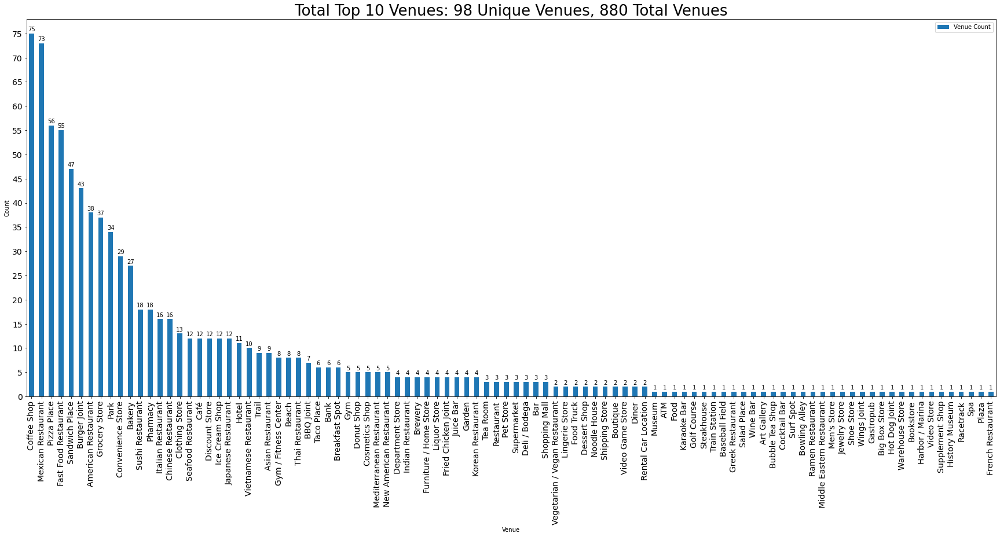

In [49]:
def ModVisAdd(x):
    AddVal = (x%10)
    x = (x+10-AddVal) if AddVal > 5 else (x+5-AddVal)
    return x

ax = DD.plot(kind='bar',x='Venue',y=['Venue Count'],fontsize=14,figsize=(30,12))
UniNum = DD.shape[0]
TotNum = DD['Venue Count'].sum()
MaxCountG = DD['Venue Count'].max()
ax.set_ylabel('Count')
ax.set_title('Total Top 10 Venues: {} Unique Venues, {} Total Venues'.format(UniNum,TotNum), fontsize = 26)
ax.set_yticks(np.arange(0,ModVisAdd(MaxCountG)+1,5))
ax.set_ylim(0,ModVisAdd(MaxCountG)+3)
for N,count in enumerate(DD['Venue Count']):
    height = count
    ax.text(N , height + 0.25,'%d' % int(height),ha='center', va='bottom')

plt.show()

# Most popular venue from top 10 most common venues by clusters.

In [50]:
MainDict = dict()
for intnum in range(kclusters):
    strname = 'Cluster {}'.format(intnum)
    EJPListo = EJP_CLLPGCV[EJP_CLLPGCV['K-Means Cluster']==intnum].reset_index(drop=True)
    d = dict()
    for j in range(EJPListo.shape[0]):
        word = EJPListo.loc[j,'1st Most Common Venue':'10th Most Common Venue']
        for c in word:
            d[c] = d.get(c,0) + 1
    DDx = pd.DataFrame.from_dict(d,orient='index')
    DDx = DDx.reset_index().rename(columns={'index':'Venue',0:'Venue Count'}).sort_values(by='Venue Count',ascending=False)
    DDx = DDx.reset_index(drop=True)
    MainDict[strname]=DDx

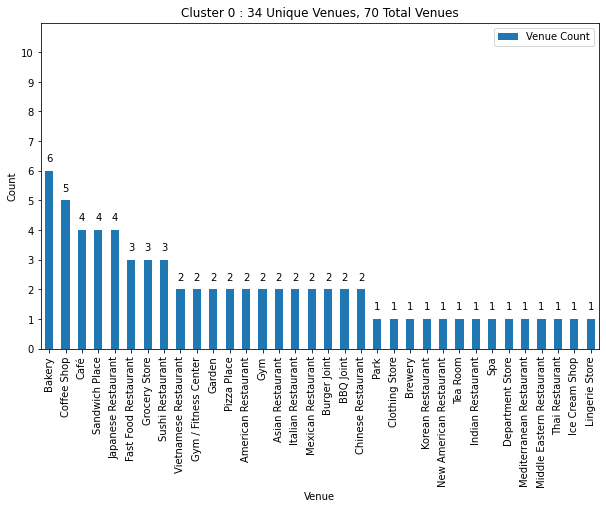

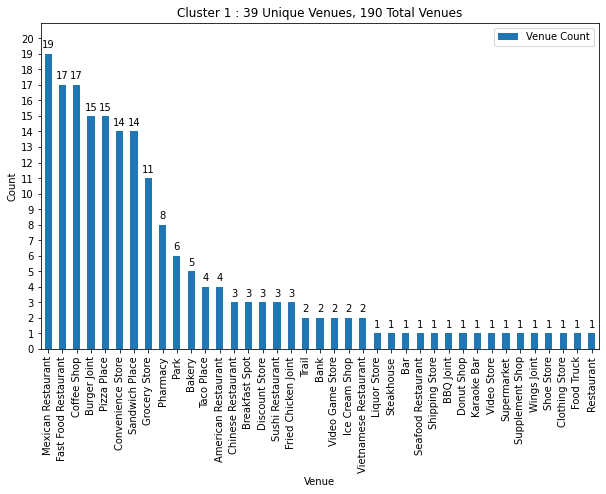

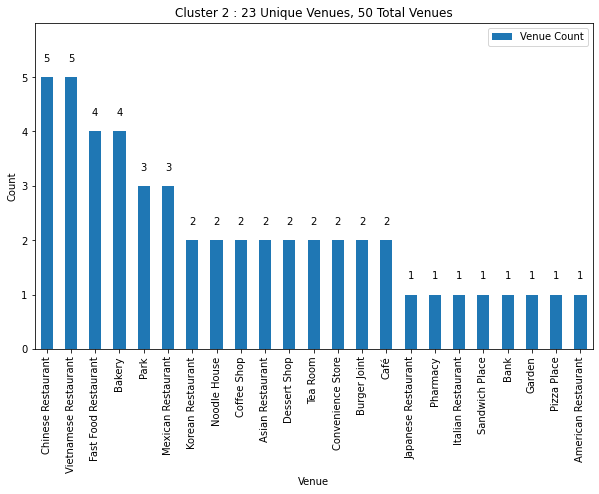

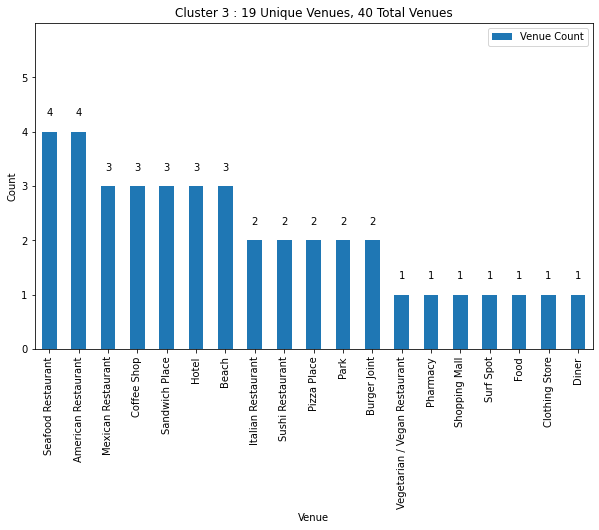

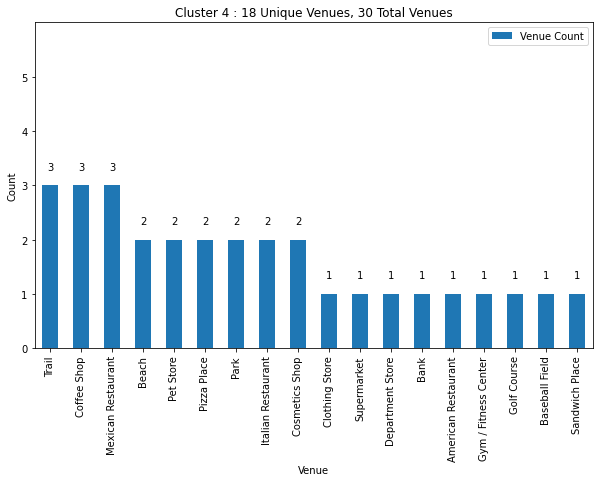

...

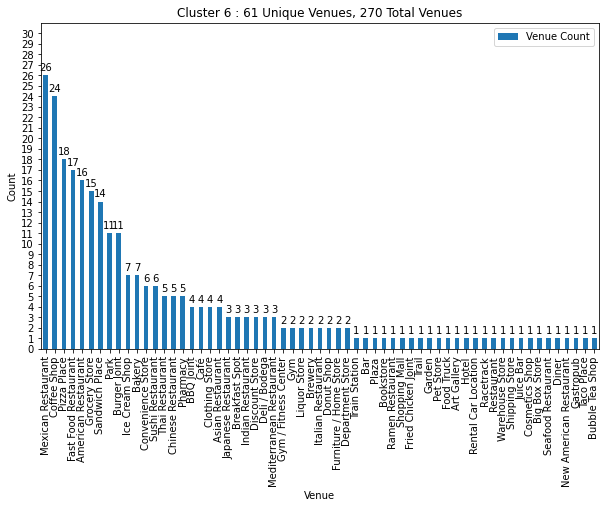

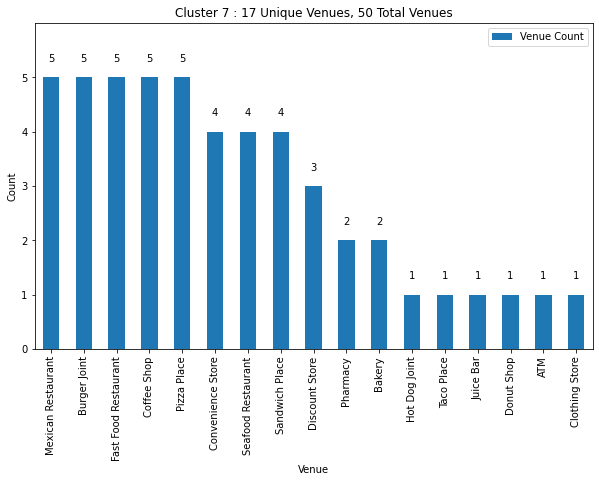

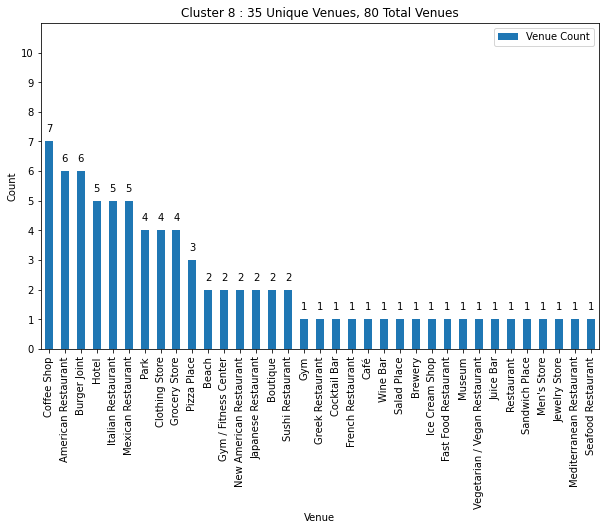

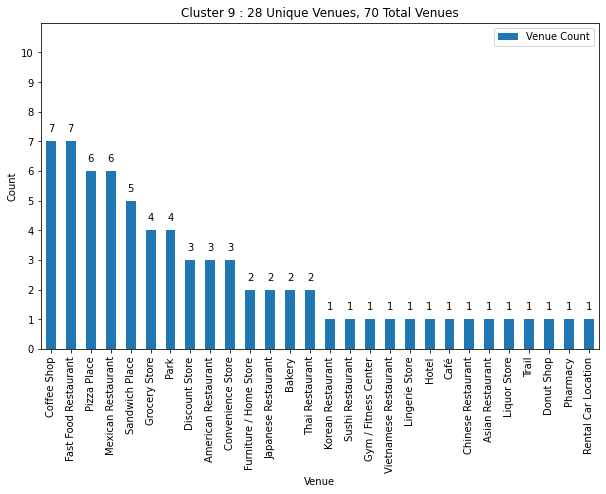

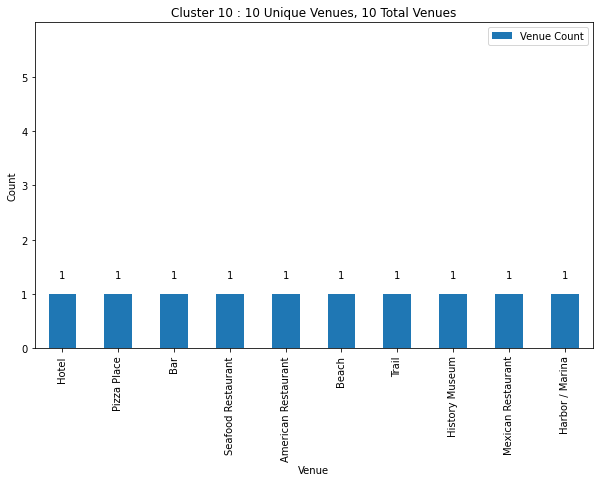

In [51]:
def ModVisAdd(x):
    AddVal = (x%10)
    x = (x+10-AddVal) if AddVal > 5 else (x+5-AddVal)
    return x

for intnum in range(kclusters):
    UniNum = MainDict['Cluster {}'.format(intnum)].shape[0]
    TotNum = MainDict['Cluster {}'.format(intnum)]['Venue Count'].sum()
    MaxCount = MainDict['Cluster {}'.format(intnum)]['Venue Count'].max()
    ax = MainDict['Cluster {}'.format(intnum)].plot(kind='bar',x='Venue',y=['Venue Count'],fontsize=10,figsize=(10,6))
    ax.set_ylabel('Count')
    ax.set_title('Cluster {} : {} Unique Venues, {} Total Venues'.format(intnum,UniNum,TotNum))
    ax.set_yticks(range(0,ModVisAdd(MaxCount)+1))
    ax.set_ylim(0,ModVisAdd(MaxCount)+1)
    for N,count in enumerate(MainDict['Cluster {}'.format(intnum)]['Venue Count']):
        height = count
        ax.text(N , height + 0.25,'%d' % int(height),ha='center', va='bottom')

plt.show()

# Does Population Size affect top Venue Categories?
The analysis below demonstrates that coffee shops and Mexican restaurants represent the venue categories with high numbers. Moreover, looking at each population group separately, we observe similar outcomes. Even in Los Angeles and Long Beach, outliers in terms of population size, we again notice that coffee shops and Mexican restaurants are abundant. This shows that regardless of population group sizes, coffee shops and Mexican restaurants are consistently going to be present within the top 10 most common venues.

## Next, let's explore how many times a venue appeared by the population groups.

In [52]:
MainDictG = dict()
for intnum in range(4):
    strname = 'Group {}'.format(intnum)
    EJP_CLLPGCV_List = EJP_CLLPGCV[EJP_CLLPGCV['Group #']==intnum].reset_index(drop=True)
    d = dict()
    for j in range(EJP_CLLPGCV_List.shape[0]):
        word = EJP_CLLPGCV_List.loc[j,'1st Most Common Venue':'10th Most Common Venue']
        for c in word:
            d[c] = d.get(c,0) + 1
    DDx = pd.DataFrame.from_dict(d,orient='index')
    DDx = DDx.reset_index().rename(columns={'index':'Venue',0:'Venue Count'}).sort_values(by='Venue Count',ascending=False)
    DDx = DDx.reset_index(drop=True)
    MainDictG[strname]=DDx

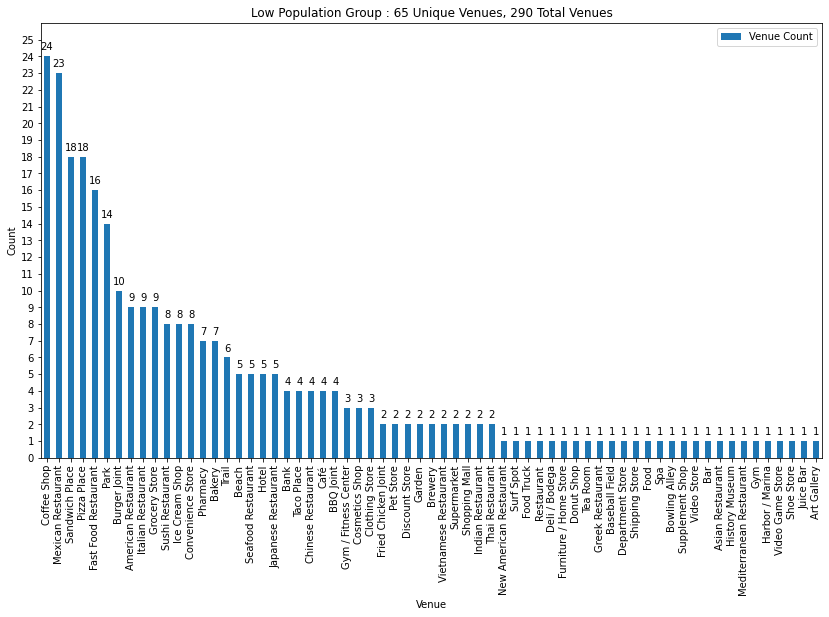

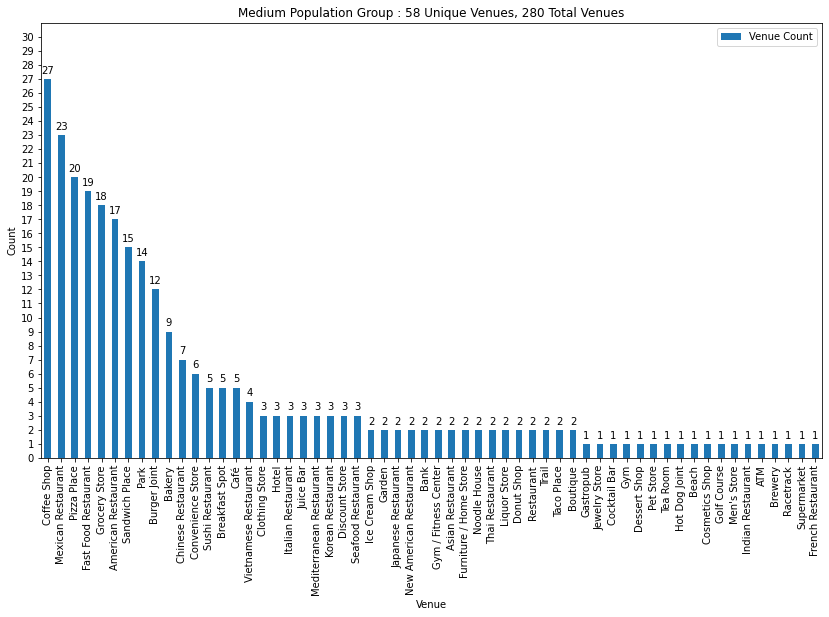

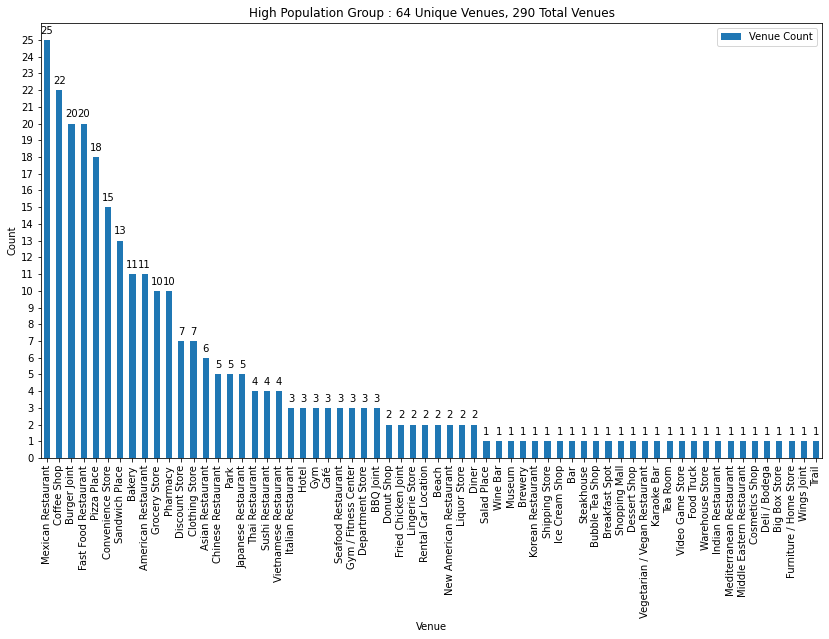

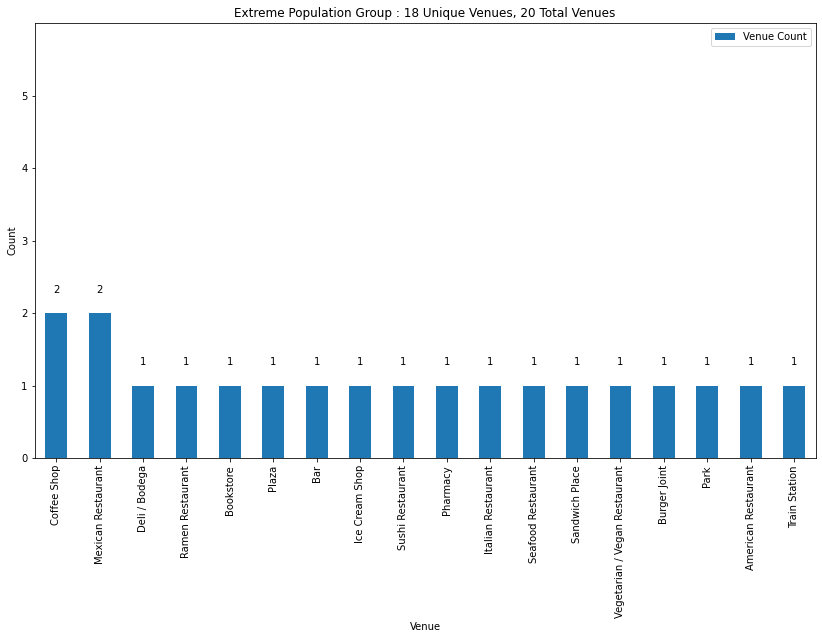

In [53]:
def ModVisAdd(x):
    AddVal = (x%10)
    x = (x+10-AddVal) if AddVal > 5 else (x+5-AddVal)
    return x
GroupListConv = {0:'Low',1:'Medium',2:'High',3:'Extreme'}

for intnum in range(4):
    UniNum = MainDictG['Group {}'.format(intnum)].shape[0]
    TotNum = MainDictG['Group {}'.format(intnum)]['Venue Count'].sum()
    MaxCountG = MainDictG['Group {}'.format(intnum)]['Venue Count'].max()
    ax = MainDictG['Group {}'.format(intnum)].plot(kind='bar',x='Venue',y=['Venue Count'],fontsize=10,figsize=(14,8))
    ax.set_ylabel('Count')
    ax.set_title('{} Population Group : {} Unique Venues, {} Total Venues'.format(GroupListConv[intnum],UniNum,TotNum))
    ax.set_yticks(range(0,ModVisAdd(MaxCountG)+1))
    ax.set_ylim(0,ModVisAdd(MaxCountG)+1)
    for N,count in enumerate(MainDictG['Group {}'.format(intnum)]['Venue Count']):
        height = count
        ax.text(N , height + 0.25,'%d' % int(height),ha='center', va='bottom')

plt.show()

# Discussion



We studied the cities within Los Angeles County using the 2010 census data and their most common venues using the foursquare API.

We attempted to understand whether any of the cities share common venue characteristics by population size, or geographical location. We applied K-means to cluster cities in similar in terms of top 10 venues, and we applied a simple 3-fold population size change (excluding the Los Angeles and Long Beach).

There were ~60 unique venue categories in each of the Low, Middle, and High population groups. Among these venue categories the data shows that regardless of population size, people are often surrounded by coffee shops and Mexican restaurants.

- Cluster 0: Bakery & Japanese Restaurant & Coffee Shop
 - Gardena, Glendale, Lomita, Torrance
- Cluster 1: Fast Food & Mexican Restaurant & Convenience Stores & Sandwich Places
 - Baldwin Park, Irwindale, Montebello, Pomona
- Cluster 2: Chinese & Vietnamese Restaurants
 - Alhambra, San Gabriel, Temple City
- Cluster 3: Seafood Restaurants & American Restaurants throughout the city.
 - Long Beach, Redondo Beach
- Cluster 4: Trail & Coffee Shop & Mexican Restaurant
 - Palos Verdes Estates, Rolling Hills
- Cluster 5: Inconclusive. Only two cities. Share Cosmetics Shop and a Bank.
 - Calabasas, Hidden Hills
- Cluster 6: Coffee Shop & Mexican Restaurant & Fast Food & Pizza, with some Sandwich Places & Parks
 - Arcadia, Burbank, Inglewood, Los Angeles,
- Cluster 7: Coffee Shop & Fast Food Restaurant & Pizza Place & Mexican Restaurant
 - Bell, Huntington Park
- Cluster 8: Coffee Shop & American Restaurant & Burger Joints & Hotels
 - Beverly Hills, Pasadena, West Hollywood
- Cluster 9: Coffee Shop & Fast Food Restaurant & Pizza Place & Mexican Restaurant (Similar to Cluster 7)
 - Diamond Bar, La Mirada, Whittier
- Cluster 10: Inconclusive. Only one city. Have a bar, beach, and history museum.
 - Avalon


The prevalence of coffee shops and Mexican restaurants was also seen in most K-Means clusters (groups of cities). Interestingly, one cluster had Japanese foods being one of the most common venues. Few other clusters preferred Chinese/Vietnamese foods and while another preferred Indian food. Some clusters did demonstrate (not all) similarities in geographical locations. For example, cities in cluster 1 seemed to be concentrated in mid-east region of Los Angeles County in high population regions.

By expanding the number of venues for each city, rather than 100, a better understanding of the top venues is obtainable. Due to the limitations of the Foursquare API for free accounts, additional studies such as venue ratings, menu items, and prices of each restaurant were not obtainable. It would be interesting to see whether those data sets can help us paint the bigger picture of the city. Another thing to consider is that this is a snapshot of the city when the data was collected. These popular venues may not shift too much, but as different venues become available and listed on the Foursquare API, the top venues change. This could lead to changes in cluster groupings as the world changes. It would be interesting to see how these changes in common venues occur over time.

# Conclusion

The project provides an informative broad picture of Los Angeles County. Some unexpected outcomes when doing this project was finding Japanese restaurant chains I didn't know existed in the United States! Some cities that came up popular for Japanese foods was Glendale and Gardena regions. The study shows Alhambra regions have many Chinese restaurants to explore.

Finally, if you love coffee or Mexican foods, they're everywhere within Los Angeles County (regardless of population, or city clustering). 

Thanks to this project, I now have an interest to explore more venues around Los Angeles County.

Let's grab some tacos/burritos while exploring Los Angeles County!

## References & Acknowledgements:

Thanks for the IBM Coursera courses and instructors for this fun opportunity to explore Los Angeles County!

Additionally, I thank the readers/learners for taking the time to read my project.

The codes used for this project is publicly available for download from my github account (https://github.com/EJPanda/Coursera_Capstone).